<a href="https://colab.research.google.com/github/tumorouw/Image-Classification/blob/main/Model_VGG_19.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#importing library for data preprocessing and folder

import os
import cv2
import numpy as np
import tensorflow as tf
from keras.preprocessing import image_dataset_from_directory

In [ ]:
# Load dataset from directory

dataset_dir = '/content/drive/MyDrive/eye_dataset'
batch_size = 32
img_size = (224, 224)

dataset = image_dataset_from_directory(dataset_dir,
                                       image_size=img_size,
                                       batch_size=batch_size,
                                       label_mode='int')

Found 4217 files belonging to 4 classes.


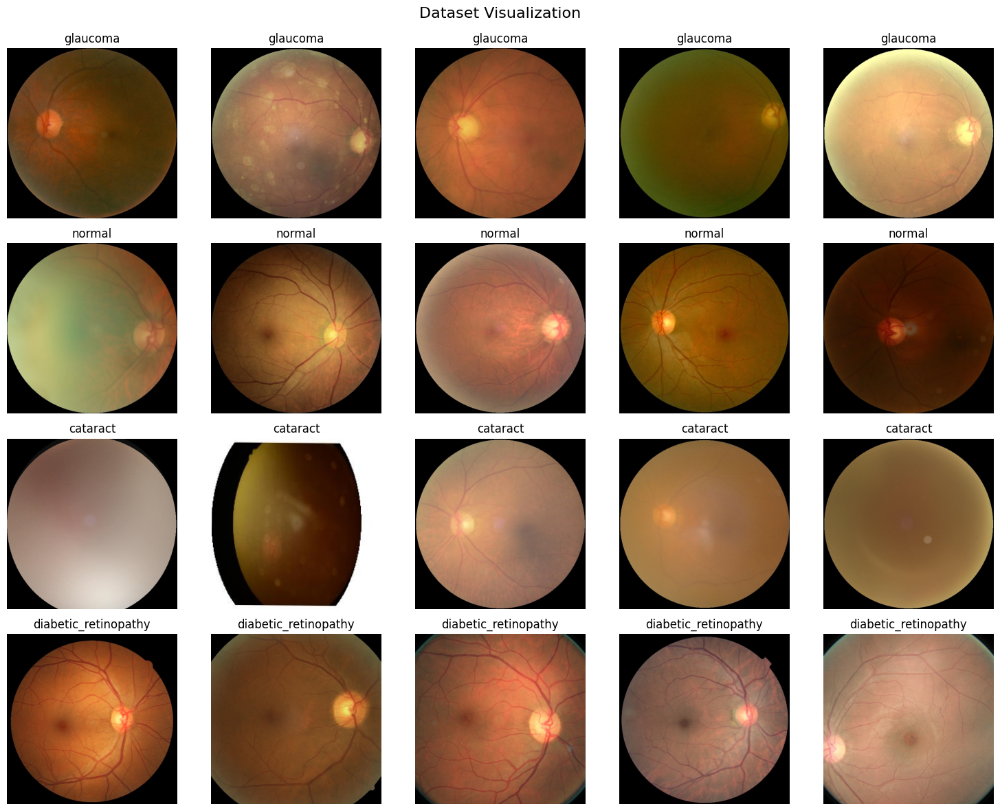

In [ ]:
#visualize sample of dataset

def load_images_from_folder(folder, num_images=3):
    images = []
    filenames = os.listdir(folder)
    for filename in filenames[:num_images]:
        img_path = os.path.join(folder, filename)
        img = cv2.imread(img_path)
        if img is not None:
            #img = cv2.resize(img, (img_width, img_height))
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
            images.append(img)
    return images

def visualize_dataset(dataset_dir, num_images=5):
    class_names = os.listdir(dataset_dir)
    num_classes = len(class_names)
    fig, axes = plt.subplots(num_classes, num_images, figsize=(num_images * 3, num_classes * 3))
    fig.suptitle('Dataset Visualization', fontsize=16)

    for class_idx, class_name in enumerate(class_names):
        class_folder = os.path.join(dataset_dir, class_name)
        images = load_images_from_folder(class_folder, num_images)
        for img_idx, img in enumerate(images):
            ax = axes[class_idx, img_idx]
            ax.imshow(img)
            ax.axis('off')
            ax.set_title(class_name, fontsize=12)

    plt.tight_layout()
    plt.subplots_adjust(top=0.93)
    plt.show()

visualize_dataset(dataset_dir)

In [ ]:
#preprocessing one: applying CLAHE

def apply_clahe(img):
    """
    Apply CLAHE (Contrast Limited Adaptive Histogram Equalization) to an image.
    """
    img_lab = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)  # Convert from RGB to LAB color space
    l, a, b = cv2.split(img_lab)  # Split the LAB image to different channels
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)  # Apply CLAHE to the L-channel
    img_lab = cv2.merge((cl, a, b))  # Merge the CLAHE enhanced L-channel with the a and b channel
    img_clahe = cv2.cvtColor(img_lab, cv2.COLOR_LAB2RGB)  # Convert from LAB to RGB color space
    return img_clahe

In [ ]:
# Load images and labels from directory with CLAHE and resize 224 x 224 pixel

def load_images_from_directory(directory):
    images = []
    labels = []
    class_names = sorted(os.listdir(directory))
    for label, class_name in enumerate(class_names):
        class_folder = os.path.join(directory, class_name)
        for filename in os.listdir(class_folder):
            img_path = os.path.join(class_folder, filename)
            img = cv2.imread(img_path)
            if img is not None:
                img = cv2.resize(img, img_size)
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = apply_clahe(img)
                images.append(img)
                labels.append(label)
    return np.array(images), np.array(labels), class_names

# Load data
images, labels, class_names = load_images_from_directory(dataset_dir)

In [ ]:
# Split data using sklearn train_test_split

X_train, X_temp, y_train, y_temp = train_test_split(images, labels, test_size=0.3, random_state=42, stratify=labels)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp)

In [ ]:
# import for making models

from tensorflow import keras
from keras import layers
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

from keras import layers, applications, models, optimizers, callbacks
from tensorflow.keras.applications import VGG19
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

#define data augmentation
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal"),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1)
])

def preprocess_and_augment(image, label):
    image = data_augmentation(image)
    image = tf.cast(image, tf.float32)
    image = tf.keras.applications.xception.preprocess_input(image)
    return image, label

def preprocess(image, label):
    image = tf.cast(image, tf.float32)
    image = tf.keras.applications.xception.preprocess_input(image)
    return image, label

# Convert to TensorFlow datasets and apply augmentation to training data
train_ds = tf.data.Dataset.from_tensor_slices((X_train, y_train)) \
    .map(preprocess_and_augment, num_parallel_calls=tf.data.experimental.AUTOTUNE) \
    .batch(batch_size) \
    .prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

val_ds = tf.data.Dataset.from_tensor_slices((X_val, y_val)) \
    .map(preprocess, num_parallel_calls=tf.data.experimental.AUTOTUNE) \
    .batch(batch_size) \
    .prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

test_ds = tf.data.Dataset.from_tensor_slices((X_test, y_test)) \
    .map(preprocess, num_parallel_calls=tf.data.experimental.AUTOTUNE) \
    .batch(batch_size) \
    .prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

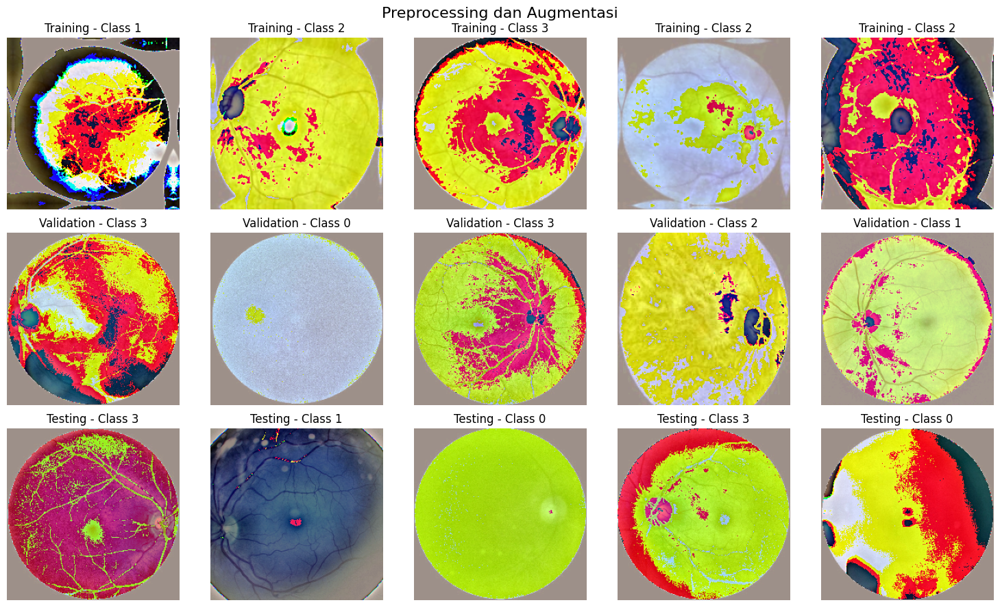

In [ ]:
# Visualize sample of preprocessing and augmentation dataset

def visualize_dataset_from_split(train_ds, val_ds, test_ds, num_images=5):
    datasets = {'Training': train_ds, 'Validation': val_ds, 'Testing': test_ds}
    fig, axes = plt.subplots(len(datasets), num_images, figsize=(num_images * 3, len(datasets) * 3))
    fig.suptitle('Preprocessing dan Augmentasi', fontsize=16)

    for ds_idx, (ds_name, ds) in enumerate(datasets.items()):
        for images, labels in ds.take(1):
            for img_idx in range(num_images):
                ax = axes[ds_idx, img_idx]
                ax.imshow(images[img_idx].numpy().astype("uint8"))
                ax.axis('off')
                ax.set_title(f"{ds_name} - Class {labels[img_idx].numpy()}", fontsize=12)

    plt.tight_layout()
    plt.subplots_adjust(top=0.93)
    plt.show()

visualize_dataset_from_split(train_ds, val_ds, test_ds)

In [ ]:
# Load the pre-trained model with pretrained weights

base_model = VGG19(weights='imagenet',
                            include_top=False,
                            input_shape=(img_size[0], img_size[1], 3))

for layer in base_model.layers:
    layer.trainable = False

# Add new layers for fine-tuning

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(4, activation='softmax')(x)

In [ ]:
# Define the model
model = Model(inputs=base_model.input, outputs=predictions)

# Compile the model
model.compile(optimizer=Adam(learning_rate=0.0001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [ ]:
model.summary(show_trainable=True)

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_4 (InputLayer)          │ (None, 224, 224, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block1_conv1 (Conv2D)               │ (None, 224, 224, 64)         │         1,792 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block1_conv2 (Conv2D)               │ (None, 224, 224, 64)         │        36,928 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block1_pool (MaxPooling2D)          │ (None, 112, 112, 64)         │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block2_conv1 (Conv2D)               │ (None, 112, 112, 128)        │        73,856 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block2_conv2 (Conv2D)               │ (None, 112, 112, 128)        │       147,584 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block2_pool (MaxPooling2D)          │ (None, 56, 56, 128)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block3_conv1 (Conv2D)               │ (None, 56, 56, 256)          │       295,168 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block3_conv2 (Conv2D)               │ (None, 56, 56, 256)          │       590,080 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block3_conv3 (Conv2D)               │ (None, 56, 56, 256)          │       590,080 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block3_conv4 (Conv2D)               │ (None, 56, 56, 256)          │       590,080 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block3_pool (MaxPooling2D)          │ (None, 28, 28, 256)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block4_conv1 (Conv2D)               │ (None, 28, 28, 512)          │     1,180,160 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block4_conv2 (Conv2D)               │ (None, 28, 28, 512)          │     2,359,808 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block4_conv3 (Conv2D)               │ (None, 28, 28, 512)          │     2,359,808 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block4_conv4 (Conv2D)               │ (None, 28, 28, 512)          │     2,359,808 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block4_pool (MaxPooling2D)          │ (None, 14, 14, 512)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block5_conv1 (Conv2D)               │ (None, 14, 14, 512)          │     2,359,808 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block5_conv2 (Conv2D)               │ (None, 14, 14, 512)          │     2,359,808 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block5_conv3 (Conv2D)

 Total params: 21,076,548 (80.40 MB)

 Trainable params: 1,052,164 (4.01 MB)

 Non-trainable params: 20,024,384 (76.39 MB)

In [ ]:
# Set up callbacks
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, verbose=1),
    ModelCheckpoint(filepath='best_model.keras', monitor='val_loss', save_best_only=True, verbose=1)
]

In [ ]:
# Train the model on the new data for a few epochs
history = model.fit(
    train_ds,
    epochs=10,
    validation_data=val_ds,
    callbacks=callbacks
)

Epoch 1/10
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step - accuracy: 0.4086 - loss: 1.2625
Epoch 1: val_loss improved from inf to 0.94687, saving model to best_model.keras
93/93 ━━━━━━━━━━━━━━━━━━━━ 63s 672ms/step - accuracy: 0.4093 - loss: 1.2617 - val_accuracy: 0.6098 - val_loss: 0.9469
Epoch 2/10
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step - accuracy: 0.5592 - loss: 1.0028
Epoch 2: val_loss improved from 0.94687 to 0.81473, saving model to best_model.keras
93/93 ━━━━━━━━━━━━━━━━━━━━ 64s 476ms/step - accuracy: 0.5595 - loss: 1.0024 - val_accuracy: 0.6730 - val_loss: 0.8147
Epoch 3/10
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 412ms/step - accuracy: 0.6140 - loss: 0.9058
Epoch 3: val_loss improved from 0.81473 to 0.75524, saving model to best_model.keras
93/93 ━━━━━━━━━━━━━━━━━━━━ 42s 449ms/step - accuracy: 0.6141 - loss: 0.9055 - val_accuracy: 0.6967 - val_loss: 0.7552
Epoch 4/10
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step - accuracy: 0.6472 - loss: 0.8456
Epoch 4: val_loss improved from 0.75524 to 0.72137,

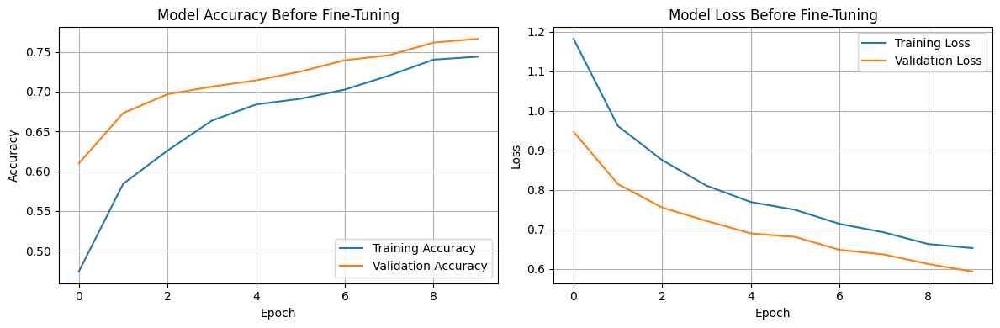

In [ ]:
# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy Before Fine-Tuning')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.grid(True)

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss Before Fine-Tuning')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.grid(True)

plt.tight_layout()
plt.show()

In [ ]:
# Tahap kedua: Unfreeze model dasar untuk fine-tuning, kecuali lapisan BatchNormalization
for layer in base_model.layers:
    if not isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = True

# Recompile the model with a lower learning rate for fine-tuning
model.compile(optimizer=Adam(learning_rate=1e-5), loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [ ]:
model.summary(show_trainable=True)

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Layer (type)                        ┃ Output Shape                 ┃       Param # ┃ Traina… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━╇━━━━━━━━━┩
│ input_layer_4 (InputLayer)          │ (None, 224, 224, 3)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block1_conv1 (Conv2D)               │ (None, 224, 224, 64)         │         1,792 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block1_conv2 (Conv2D)               │ (None, 224, 224, 64)         │        36,928 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block1_pool (MaxPooling2D)          │ (None, 112, 112, 64)         │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block2_conv1 (Conv2D)               │ (None, 112, 112, 128)        │        73,856 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block2_conv2 (Conv2D)               │ (None, 112, 112, 128)        │       147,584 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block2_pool (MaxPooling2D)          │ (None, 56, 56, 128)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block3_conv1 (Conv2D)               │ (None, 56, 56, 256)          │       295,168 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block3_conv2 (Conv2D)               │ (None, 56, 56, 256)          │       590,080 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block3_conv3 (Conv2D)               │ (None, 56, 56, 256)          │       590,080 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block3_conv4 (Conv2D)               │ (None, 56, 56, 256)          │       590,080 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block3_pool (MaxPooling2D)          │ (None, 28, 28, 256)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block4_conv1 (Conv2D)               │ (None, 28, 28, 512)          │     1,180,160 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block4_conv2 (Conv2D)               │ (None, 28, 28, 512)          │     2,359,808 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block4_conv3 (Conv2D)               │ (None, 28, 28, 512)          │     2,359,808 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block4_conv4 (Conv2D)               │ (None, 28, 28, 512)          │     2,359,808 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block4_pool (MaxPooling2D)          │ (None, 14, 14, 512)          │             0 │    -    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block5_conv1 (Conv2D)               │ (None, 14, 14, 512)          │     2,359,808 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block5_conv2 (Conv2D)               │ (None, 14, 14, 512)          │     2,359,808 │    N    │
├─────────────────────────────────────┼──────────────────────────────┼───────────────┼─────────┤
│ block5_conv3 (Conv2D)

 Total params: 21,076,548 (80.40 MB)

 Trainable params: 1,052,164 (4.01 MB)

 Non-trainable params: 20,024,384 (76.39 MB)

In [ ]:
# Fine-tune the model
fine_tune_epochs = 10
total_epochs = 10 + fine_tune_epochs

history_fine = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=total_epochs,
    initial_epoch=history.epoch[-1],
    callbacks=callbacks
)

# Load the best model
model.load_weights('best_model.keras')

Epoch 10/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step - accuracy: 0.7568 - loss: 0.6239
Epoch 10: val_loss improved from 0.59331 to 0.58759, saving model to best_model.keras
93/93 ━━━━━━━━━━━━━━━━━━━━ 50s 479ms/step - accuracy: 0.7568 - loss: 0.6239 - val_accuracy: 0.7709 - val_loss: 0.5876
Epoch 11/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 423ms/step - accuracy: 0.7687 - loss: 0.6069
Epoch 11: val_loss improved from 0.58759 to 0.58696, saving model to best_model.keras
93/93 ━━━━━━━━━━━━━━━━━━━━ 43s 461ms/step - accuracy: 0.7686 - loss: 0.6071 - val_accuracy: 0.7725 - val_loss: 0.5870
Epoch 12/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step - accuracy: 0.7640 - loss: 0.6157
Epoch 12: val_loss improved from 0.58696 to 0.58315, saving model to best_model.keras
93/93 ━━━━━━━━━━━━━━━━━━━━ 41s 444ms/step - accuracy: 0.7639 - loss: 0.6157 - val_accuracy: 0.7773 - val_loss: 0.5831
Epoch 13/20
93/93 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step - accuracy: 0.7595 - loss: 0.6038
Epoch 13: val_loss improved from 0.58315

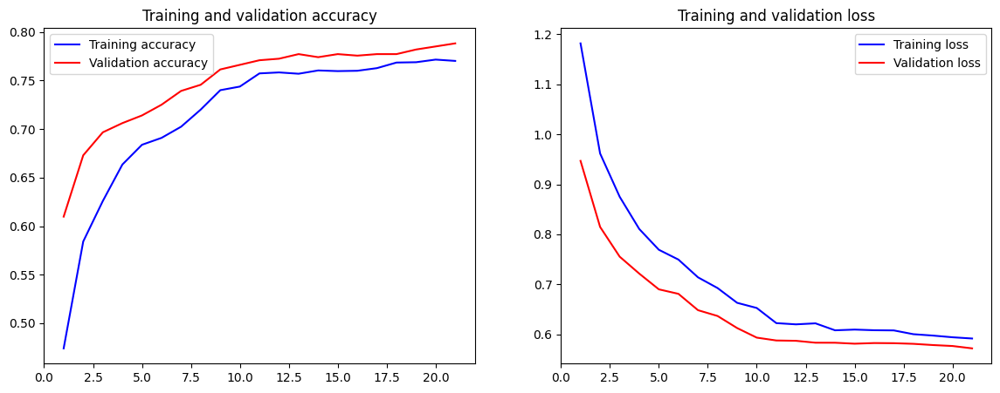

In [ ]:
# Plotting the training history
def plot_training_history(history, fine_tune=False):
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    if fine_tune:
        acc += history_fine.history['accuracy']
        val_acc += history_fine.history['val_accuracy']
        loss += history_fine.history['loss']
        val_loss += history_fine.history['val_loss']

    epochs = range(1, len(acc) + 1)

    plt.figure(figsize=(14, 5))

    plt.subplot(1, 2, 1)
    plt.plot(epochs, acc, 'b', label='Training accuracy')
    plt.plot(epochs, val_acc, 'r', label='Validation accuracy')
    plt.title('Training and validation accuracy')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs, loss, 'b', label='Training loss')
    plt.plot(epochs, val_loss, 'r', label='Validation loss')
    plt.title('Training and validation loss')
    plt.legend()

    plt.show()

# Plotting the training and fine-tuning history
plot_training_history(history, fine_tune=True)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


<ipython-input-27-07fea486188e>:34: RuntimeWarning: invalid value encountered in divide
  feature_map /= feature_map.std()
<ipython-input-27-07fea486188e>:37: RuntimeWarning: invalid value encountered in cast
  feature_map = np.clip(feature_map, 0, 255).astype('uint8')


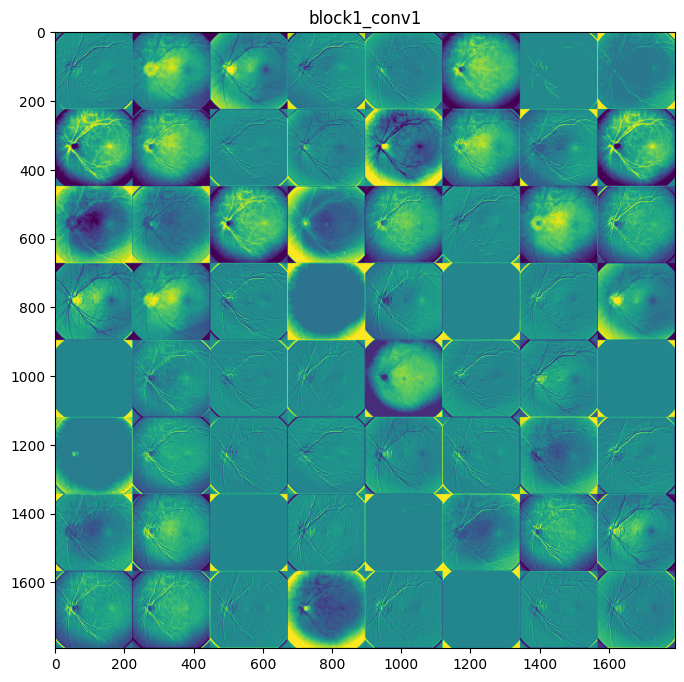

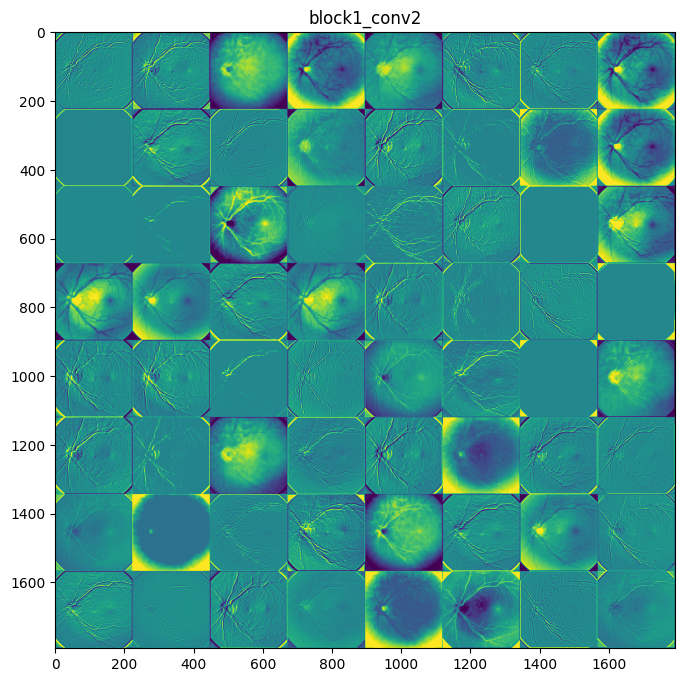

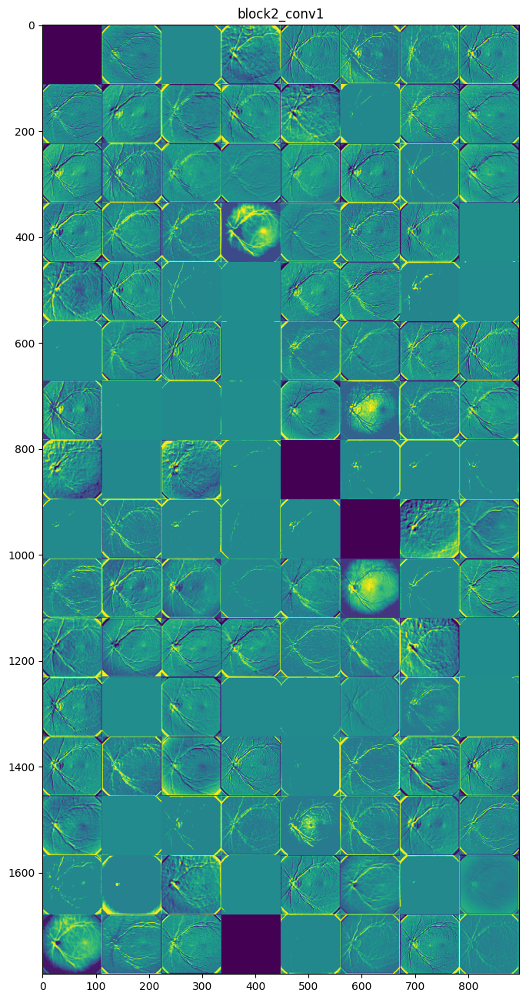

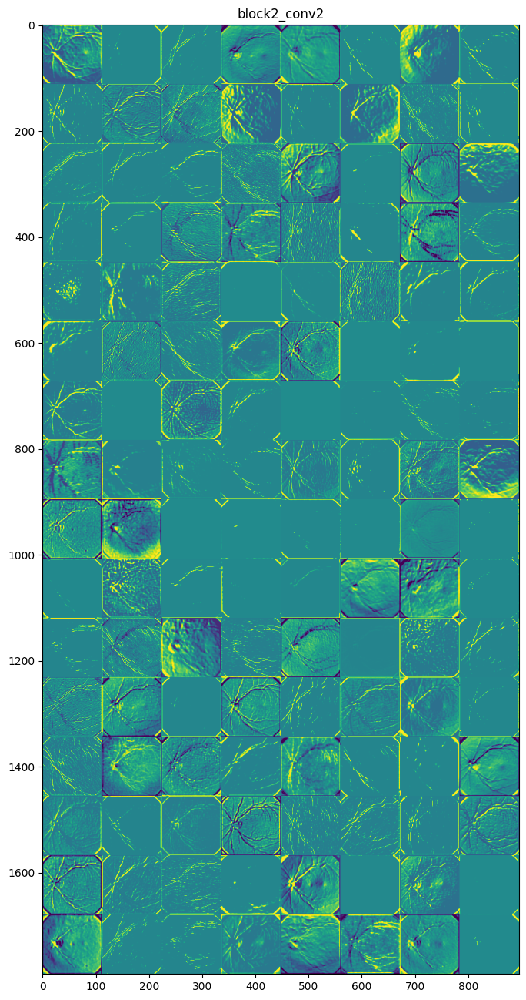

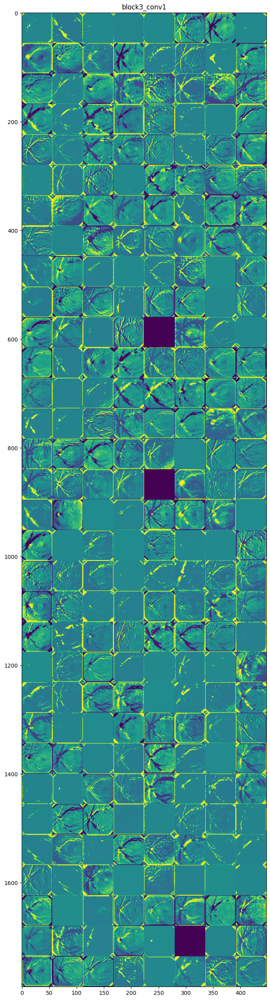

...

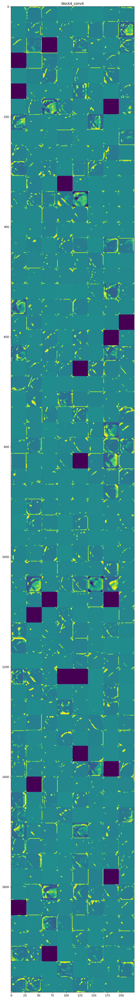

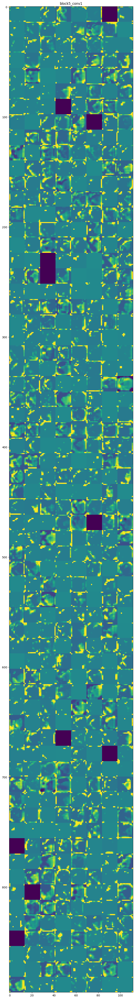

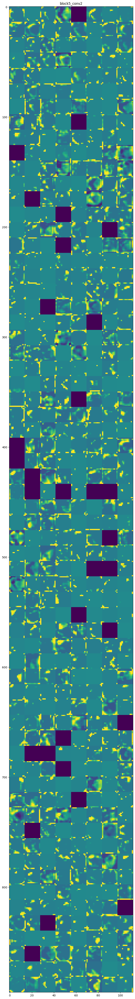

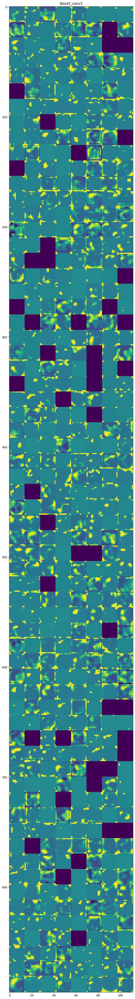

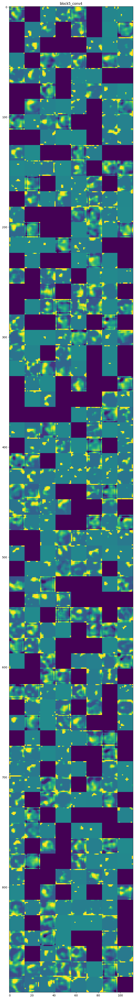

In [ ]:
# Feature map visualization
# Load a sample image
img = tf.keras.preprocessing.image.load_img('/content/drive/MyDrive/eye_dataset/diabetic_retinopathy/1000_right.jpeg', target_size=(224, 224))
img = tf.keras.preprocessing.image.img_to_array(img)
img = np.expand_dims(img, axis=0)
img = img / 255.0  # Normalize the image

# Get the names of all convolutional layers
layer_names = [layer.name for layer in model.layers if 'conv' in layer.name]

# Create a new model that outputs the activations of these layers
outputs = [model.get_layer(name).output for name in layer_names]
activation_model = Model(inputs=model.input, outputs=outputs)

# Get the feature maps for the image
activations = activation_model.predict(img)

# Function to plot feature maps
def plot_feature_maps(activations, layer_names):
    for layer_name, layer_activation in zip(layer_names, activations):
        num_features = layer_activation.shape[-1]  # Number of filters
        size = layer_activation.shape[1]  # Feature map size (height or width)

        # Number of feature maps in a grid
        n_cols = 8  # You can change this value depending on your needs
        n_rows = num_features // n_cols

        display_grid = np.zeros((size * n_rows, size * n_cols))

        for i in range(n_rows):
            for j in range(n_cols):
                feature_map = layer_activation[0, :, :, i * n_cols + j]
                feature_map -= feature_map.mean()
                feature_map /= feature_map.std()
                feature_map *= 64
                feature_map += 128
                feature_map = np.clip(feature_map, 0, 255).astype('uint8')

                display_grid[i * size : (i + 1) * size,
                             j * size : (j + 1) * size] = feature_map

        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

# Call the function for each layer
plot_feature_maps(activations, layer_names)
plt.show()


20/20 ━━━━━━━━━━━━━━━━━━━━ 5s 184ms/step
Classification Report:
                       precision    recall  f1-score   support

            cataract       0.83      0.91      0.87       156
diabetic_retinopathy       0.88      0.80      0.84       165
            glaucoma       0.77      0.67      0.71       151
              normal       0.67      0.75      0.71       161

            accuracy                           0.78       633
           macro avg       0.79      0.78      0.78       633
        weighted avg       0.79      0.78      0.78       633

Confusion Matrix:
 [[142   0   7   7]
 [  2 132   7  24]
 [ 16   6 101  28]
 [ 11  12  17 121]]


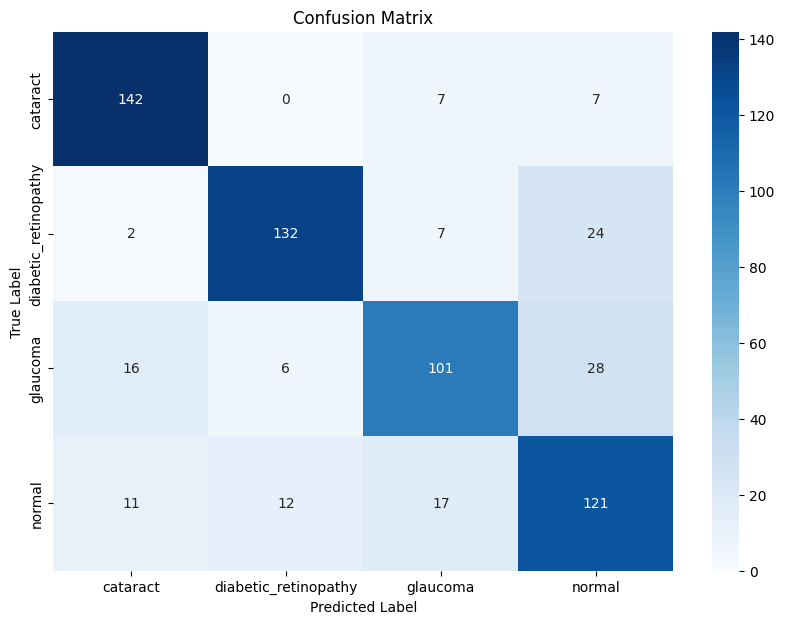

In [ ]:
# Predict labels for the test set
y_pred_probs = model.predict(test_ds)
y_pred = np.argmax(y_pred_probs, axis=1)

# Calculate classification report
report = classification_report(y_test, y_pred, target_names=class_names)
print("Classification Report:\n", report)

# Calculate confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:\n", conf_matrix)

#visualize the confusion matrix
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

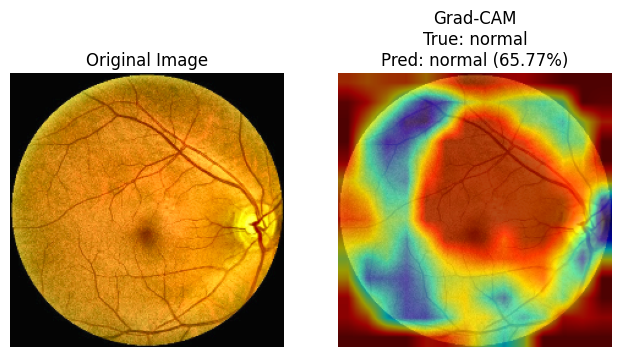

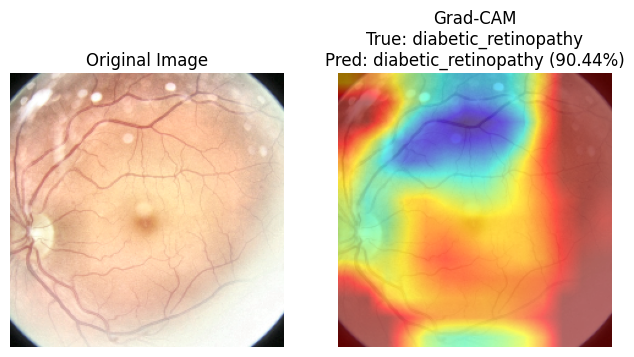

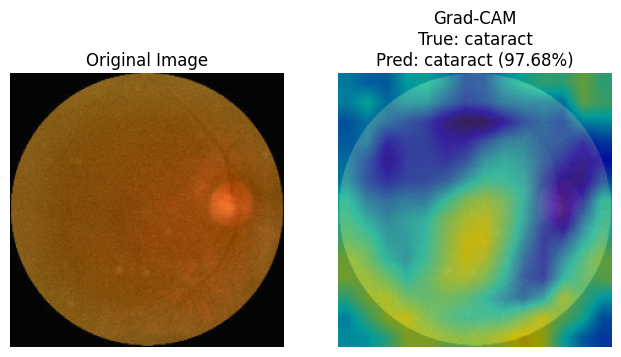

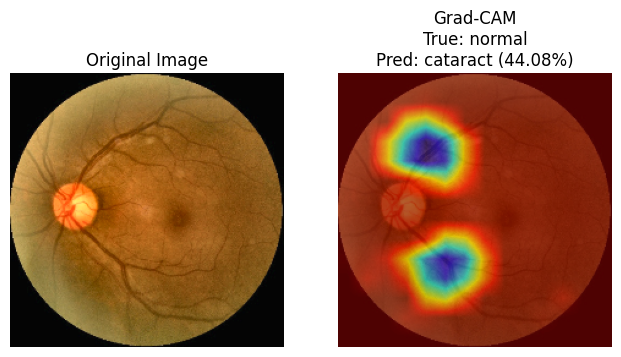

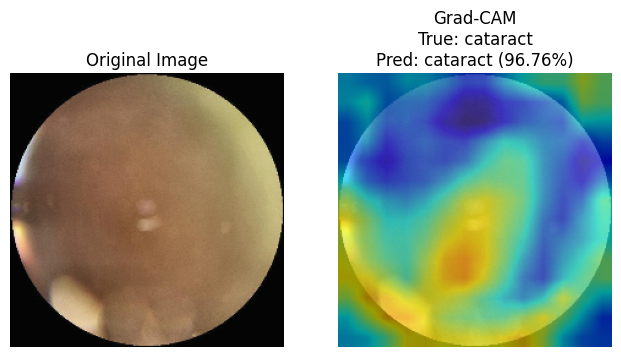

In [ ]:
def get_gradcam_heatmap(model, img_array, class_index, layer_name):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        loss = predictions[:, class_index]

    grads = tape.gradient(loss, conv_outputs)[0]
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1))

    conv_outputs = conv_outputs[0].numpy()
    pooled_grads = pooled_grads.numpy()

    for i in range(pooled_grads.shape[-1]):
        conv_outputs[:, :, i] *= pooled_grads[i]

    heatmap = np.mean(conv_outputs, axis=-1)
    heatmap = np.maximum(heatmap, 0) / np.max(heatmap)
    return heatmap, predictions[0]

def apply_heatmap(image, heatmap, alpha=0.4, colormap=cv2.COLORMAP_JET):
    heatmap = cv2.resize(heatmap, (image.shape[1], image.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, colormap)
    overlay = cv2.addWeighted(image, alpha, heatmap, 1 - alpha, 0)
    return overlay

# last conv name layer
last_conv_layer_name = "block5_conv4"

# label def
class_labels = ["cataract", "diabetic_retinopathy", "glaucoma", "normal"]

# take some image from test set
sample_test_images = X_test[:5]
sample_test_labels = y_test[:5]

# Rescale image
sample_test_images_rescaled = sample_test_images / 255.0

for i in range(len(sample_test_images)):
    img_array = np.expand_dims(sample_test_images_rescaled[i], axis=0)
    true_class_index = sample_test_labels[i]
    heatmap, predictions = get_gradcam_heatmap(model, img_array, true_class_index, last_conv_layer_name)

    # Apply heatmap to the original image
    original_img = sample_test_images[i]
    heatmap_img = apply_heatmap(original_img, heatmap)

    # Get the class label and prediction
    true_label = class_labels[true_class_index]
    pred_class_index = np.argmax(predictions)
    pred_label = class_labels[pred_class_index]
    pred_percentage = predictions[pred_class_index] * 100

    # Plot original and heatmap images
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.title("Original Image")
    plt.imshow(original_img)
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title(f"Grad-CAM\nTrue: {true_label}\nPred: {pred_label} ({pred_percentage:.2f}%)")
    plt.imshow(heatmap_img)
    plt.axis('off')

    plt.show()